<div style="border-radius:10px; border:#879410 solid; padding: 15px; background-color: #e8f573; font-size:100%; text-align:left">

<h3 align="left"><font color='#5c6317'>Deep Convolutional GAN (DCGAN):</font></h3>
    
**DCGAN** is one of the most popular and also the most successful implementations of GAN. It is composed of ConvNets in place of multi-layer perceptrons. The ConvNets are implemented without max pooling, which is in fact replaced by convolutional stride. Also, the layers are not fully connected.

### <p style="font-family:JetBrains Mono; font-weight:bold; letter-spacing: 2px; color:#5c6317; font-size:140%; text-align:left;padding: 10px; border-bottom: 3px solid #879410"> Import Libraries</p>

In [1]:
!pip install torchvision

In [2]:
import os
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as tt
import torch
import torch.nn as nn
import cv2
from tqdm.notebook import tqdm
import torch.nn.functional as F
from torchvision.utils import save_image
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

sns.set(style='darkgrid', font_scale=1.2)

### <p style="font-family:JetBrains Mono; font-weight:bold; letter-spacing: 2px; color:#5c6317; font-size:140%; text-align:left;padding: 10px; border-bottom: 3px solid #879410"> Loading and Preprocessing Dataset</p>

In [9]:
DATA_DIR = '/kaggle/input/healthy-sam'

In [51]:
image_size = 256
batch_size = 16
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

In [52]:
train_ds = ImageFolder(DATA_DIR, transform=tt.Compose([
    tt.Resize(image_size),
    tt.CenterCrop(image_size),
    tt.ToTensor(),
    tt.Normalize(*stats)
]))

In [53]:
train_dl = DataLoader(train_ds, batch_size, shuffle=True, num_workers=2, pin_memory=True)

In [14]:
# stats = torch.tensor(stats).clone().detach().to('cuda')
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

    


In [15]:
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(16, 16))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))    

def show_batch(dl, nmax=64):
    for images, _ in dl:
        show_images(images, nmax)
        break

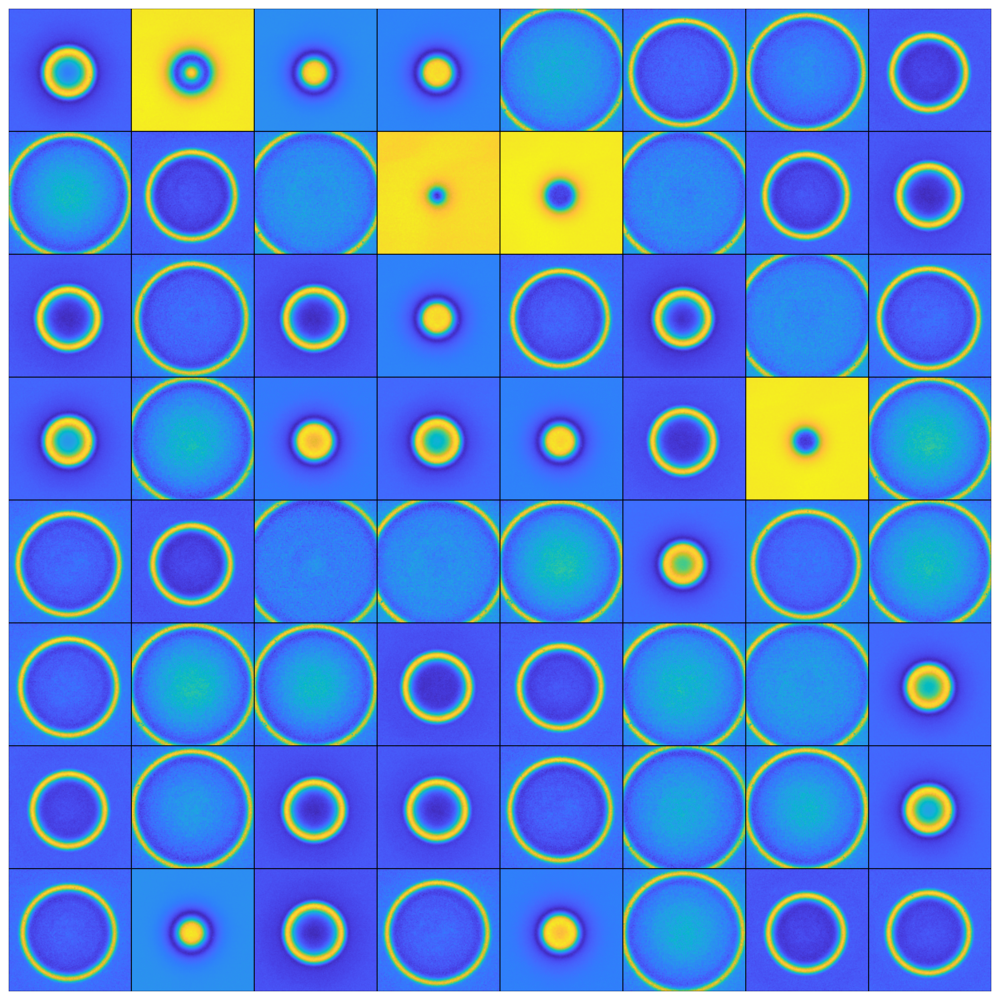

In [16]:
show_batch(train_dl)

In [17]:
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [18]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
device

device(type='cuda')

In [54]:
train_dl = DeviceDataLoader(train_dl, device)

### <p style="font-family:JetBrains Mono; font-weight:bold; letter-spacing: 2px; color:#5c6317; font-size:140%; text-align:left;padding: 10px; border-bottom: 3px solid #879410">Discriminator Network </p>

In [20]:
discriminator = nn.Sequential(
    # in: 3 x 64 x 64      # in: 3 x 256 x 256  

    nn.Conv2d(3, 32, kernel_size=6, stride=4, padding=1, bias=False),
    nn.BatchNorm2d(32),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 32 x 32 x 32    # out: 32 x 64 x 64
    
    nn.Conv2d(32, 64, kernel_size=6, stride=4, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x 32 x 32    # out: 64 x 16 x 16

    nn.Conv2d(64, 128, kernel_size=6, stride=4, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 16 x 16    # out: 128 x 4 x 4

    nn.Conv2d(128, 1, kernel_size=4, stride=1, padding=0, bias=False),
    # out: 1 x 1 x 1

    nn.Flatten(),
    nn.Sigmoid()
)

In [21]:
discriminator = to_device(discriminator, device)

In [22]:
latent_size = 512

### <p style="font-family:JetBrains Mono; font-weight:bold; letter-spacing: 2px; color:#5c6317; font-size:140%; text-align:left;padding: 10px; border-bottom: 3px solid #879410">Generator Network </p>

In [30]:
generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose2d(latent_size, 128, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 512 x 4 x 4    # out: 128 x 4 x 4

    nn.ConvTranspose2d(128, 64, kernel_size=6, stride=4, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # out: 128 x 16 x 16    # out: 128 x 16 x 16

    nn.ConvTranspose2d(64, 32, kernel_size=6, stride=4, padding=1, bias=False),
    nn.BatchNorm2d(32),
    nn.ReLU(True),
    # out: 128 x 16 x 16    # out: 128 x 64 x 64

    nn.ConvTranspose2d(32, 3, kernel_size=6, stride=4, padding=1, bias=False),
    nn.Tanh()
    # out: 3 x 64 x 64     # out: 3 x 256 x 256

)

torch.Size([128, 3, 256, 256])


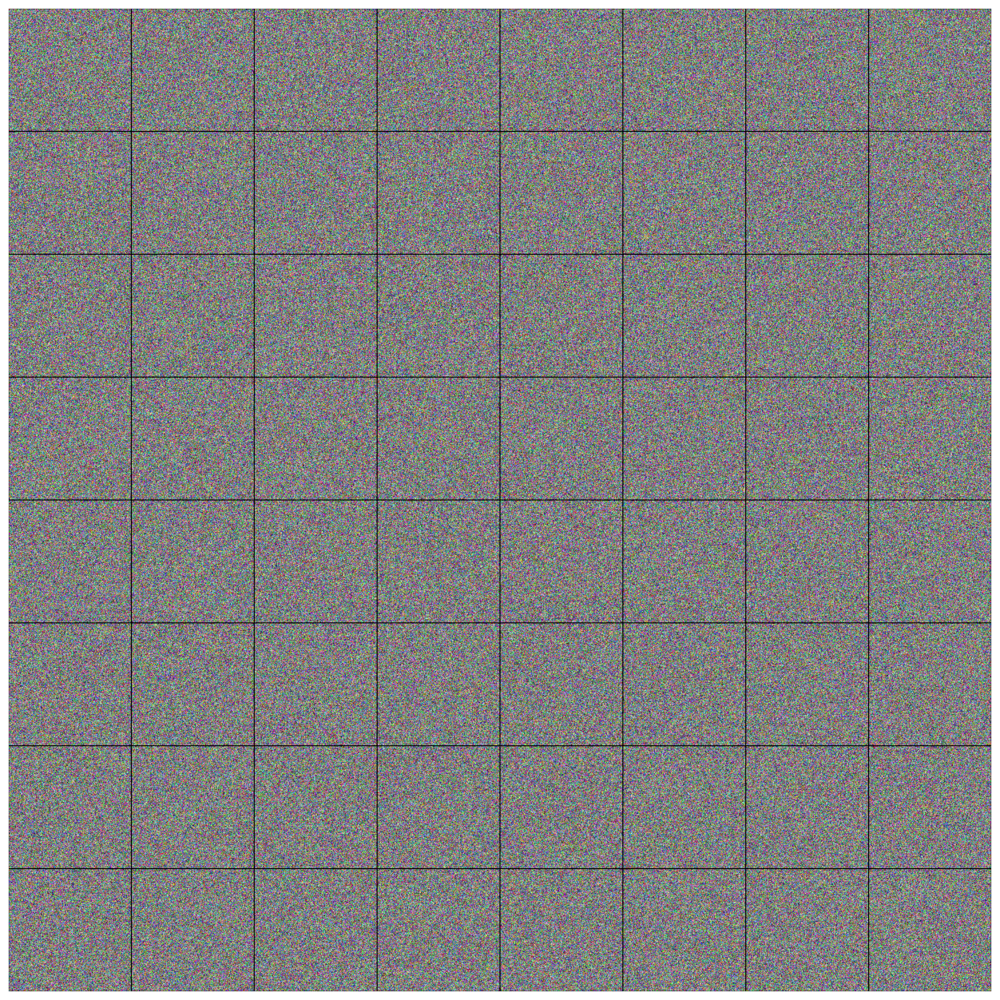

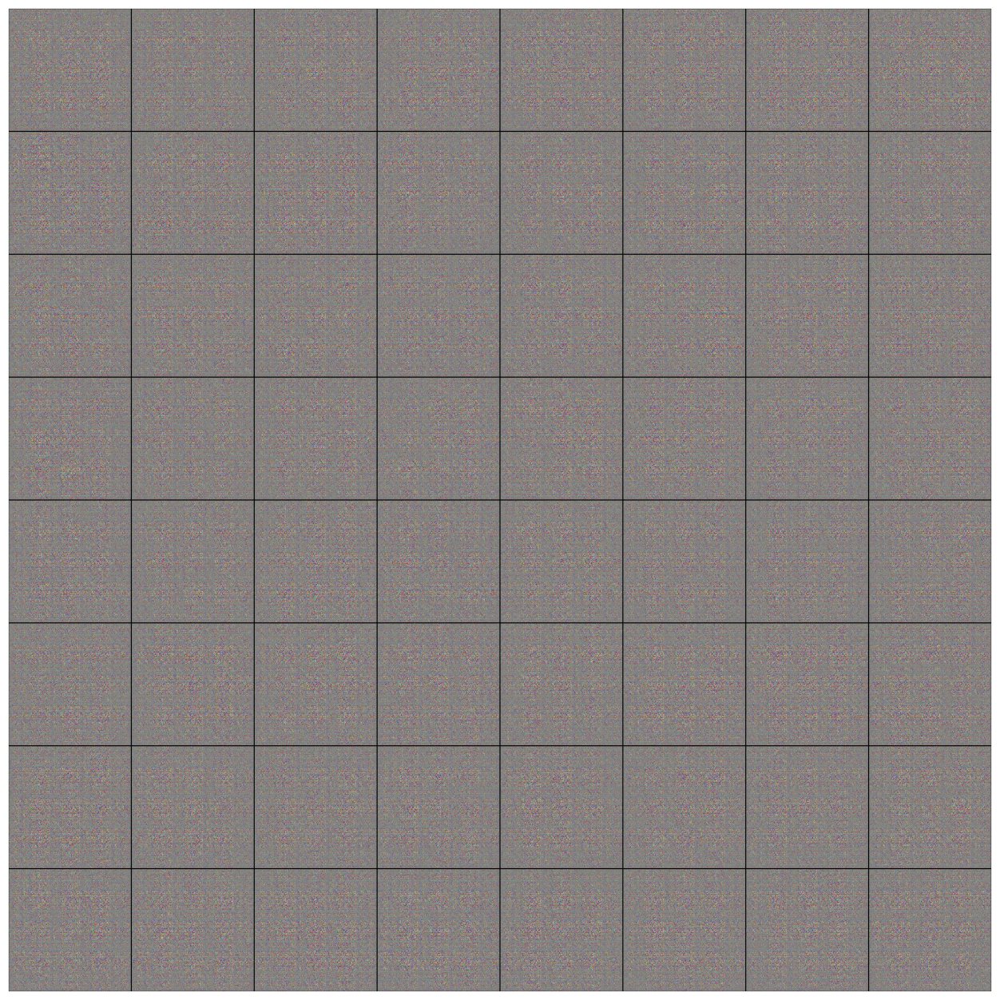

In [31]:
xb = torch.randn(batch_size, latent_size, 1, 1) 
fake_images = torch.randn(batch_size, 3, 256, 256)
print(fake_images.shape)
show_images(fake_images)
fake_images = generator(xb)
show_images(fake_images)

In [32]:
generator = to_device(generator, device)

In [33]:
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)

In [34]:
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

In [87]:
def save_samples(index, latent_tensors, show=True, save_as_200 = False):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    denormed_fake = denorm(fake_images)
    if save_as_200:
        denormed_fake = tt.Resize(200)(denormed_fake)
    save_image(denormed_fake, os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(16, 16))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))

### <p style="font-family:JetBrains Mono; font-weight:bold; letter-spacing: 2px; color:#5c6317; font-size:140%; text-align:left;padding: 10px; border-bottom: 3px solid #879410">Training the Network </p>

In [55]:
def fit(model, criterion, epochs, lr_discriminator, lr_generator, start_idx=1):
    model["discriminator"].train()
    model["generator"].train()
    torch.cuda.empty_cache()
    
    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    gen_scores = []
    
    # Create optimizers
    optimizer = {
        "discriminator": torch.optim.Adam(model["discriminator"].parameters(), 
                                          lr=lr_discriminator, betas=(0.5, 0.999)),
        "generator": torch.optim.Adam(model["generator"].parameters(),
                                      lr=lr_generator, betas=(0.5, 0.999))
    }
    
    for epoch in range(epochs):
        loss_d_per_epoch = []
        loss_g_per_epoch = []
        real_score_per_epoch = []
        fake_score_per_epoch = []
        gen_score_per_epoch = []
        for real_images, _ in tqdm(train_dl):
            # Train discriminator
            # Clear discriminator gradients
            optimizer["discriminator"].zero_grad()

            # Pass real images through discriminator
            real_preds = model["discriminator"](real_images)
            real_targets = torch.ones(real_images.size(0), 1, device=device)
            real_loss = criterion["discriminator"](real_preds, real_targets)
            cur_real_score = torch.mean(real_preds).item()
            
            # Generate fake images
            latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
            fake_images = model["generator"](latent)

            # Pass fake images through discriminator
            fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
            fake_preds = model["discriminator"](fake_images)
            fake_loss = criterion["discriminator"](fake_preds, fake_targets)
            cur_fake_score = torch.mean(fake_preds).item()

            # Update discriminator weights
            loss_d = real_loss + fake_loss
            loss_d.backward()
            optimizer["discriminator"].step()
            loss_d_per_epoch.append(loss_d.item())


            # Train generator
            # Clear generator gradients
            optimizer["generator"].zero_grad()
            
            # Generate fake images
            latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
            fake_images = model["generator"](latent)
            
            # Try to fool the discriminator
            gen_preds = model["discriminator"](fake_images)
            targets = torch.ones(batch_size, 1, device=device)
            loss_g = criterion["generator"](gen_preds, targets)
            cur_gen_score = torch.mean(gen_preds).item()

            real_score_per_epoch.append(cur_real_score)
            fake_score_per_epoch.append(cur_fake_score)            
            gen_score_per_epoch.append(cur_gen_score)
            
            # Update generator weights
            loss_g.backward()
            optimizer["generator"].step()
            loss_g_per_epoch.append(loss_g.item())
            
        # Record losses & scores
        losses_g.append(np.mean(loss_g_per_epoch))
        losses_d.append(np.mean(loss_d_per_epoch))
        real_scores.append(np.mean(real_score_per_epoch))
        fake_scores.append(np.mean(fake_score_per_epoch))
        gen_scores.append(np.mean(gen_score_per_epoch))

        
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}, gen_score: {:.4f}".format(
            epoch+1, epochs, 
            losses_g[-1], losses_d[-1], real_scores[-1], fake_scores[-1], gen_scores[-1]))
    
        # Save generated images
#         if epoch == epochs - 1:
        save_samples(epoch+start_idx, fixed_latent, show=False)
    
    return losses_g, losses_d, real_scores, fake_scores

In [78]:
model = {
    "discriminator": discriminator.to(device),
    "generator": generator.to(device)
}

criterion = {
    "discriminator": nn.BCELoss(),
    "generator": nn.BCELoss()
}
lr_discriminator = 0.0001 # default 2e-4  for TL use: 1e-5
lr_generator = 0.0001 # default 2e-4  for TL use: 1e-5
epochs = 55

In [79]:
history = fit(model, criterion, epochs, lr_discriminator, lr_generator)

  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [1/55], loss_g: 7.2200, loss_d: 0.0724, real_score: 0.9630, fake_score: 0.0110, gen_score: 0.0113
Saving generated-images-0001.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [2/55], loss_g: 5.7246, loss_d: 0.0205, real_score: 0.9921, fake_score: 0.0119, gen_score: 0.0257
Saving generated-images-0002.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [3/55], loss_g: 7.3578, loss_d: 0.0130, real_score: 0.9949, fake_score: 0.0073, gen_score: 0.0083
Saving generated-images-0003.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [4/55], loss_g: 7.3170, loss_d: 0.0104, real_score: 0.9954, fake_score: 0.0055, gen_score: 0.0045
Saving generated-images-0004.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [5/55], loss_g: 8.2420, loss_d: 0.0150, real_score: 0.9911, fake_score: 0.0054, gen_score: 0.0029
Saving generated-images-0005.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [6/55], loss_g: 7.4159, loss_d: 0.0724, real_score: 0.9790, fake_score: 0.0269, gen_score: 0.0109
Saving generated-images-0006.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [7/55], loss_g: 5.8705, loss_d: 0.2660, real_score: 0.9315, fake_score: 0.0485, gen_score: 0.0539
Saving generated-images-0007.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [8/55], loss_g: 5.8569, loss_d: 0.1486, real_score: 0.9574, fake_score: 0.0537, gen_score: 0.0592
Saving generated-images-0008.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [9/55], loss_g: 6.0650, loss_d: 0.0438, real_score: 0.9814, fake_score: 0.0210, gen_score: 0.0176
Saving generated-images-0009.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [10/55], loss_g: 7.0373, loss_d: 0.0257, real_score: 0.9918, fake_score: 0.0151, gen_score: 0.0042
Saving generated-images-0010.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [11/55], loss_g: 6.2527, loss_d: 0.0219, real_score: 0.9872, fake_score: 0.0081, gen_score: 0.0118
Saving generated-images-0011.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [12/55], loss_g: 6.1582, loss_d: 0.0140, real_score: 0.9949, fake_score: 0.0086, gen_score: 0.0143
Saving generated-images-0012.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [13/55], loss_g: 6.6457, loss_d: 0.1447, real_score: 0.9482, fake_score: 0.0281, gen_score: 0.0129
Saving generated-images-0013.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [14/55], loss_g: 5.0709, loss_d: 0.2616, real_score: 0.9402, fake_score: 0.0779, gen_score: 0.0524
Saving generated-images-0014.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [15/55], loss_g: 6.2013, loss_d: 0.0689, real_score: 0.9765, fake_score: 0.0313, gen_score: 0.0239
Saving generated-images-0015.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [16/55], loss_g: 6.2528, loss_d: 0.0374, real_score: 0.9819, fake_score: 0.0151, gen_score: 0.0130
Saving generated-images-0016.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [17/55], loss_g: 5.8869, loss_d: 0.0208, real_score: 0.9914, fake_score: 0.0081, gen_score: 0.0186
Saving generated-images-0017.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [18/55], loss_g: 6.4503, loss_d: 0.0796, real_score: 0.9744, fake_score: 0.0304, gen_score: 0.0300
Saving generated-images-0018.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [19/55], loss_g: 6.7934, loss_d: 0.0290, real_score: 0.9878, fake_score: 0.0130, gen_score: 0.0079
Saving generated-images-0019.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [20/55], loss_g: 7.3003, loss_d: 0.0320, real_score: 0.9830, fake_score: 0.0122, gen_score: 0.0089
Saving generated-images-0020.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [21/55], loss_g: 5.9897, loss_d: 0.0141, real_score: 0.9960, fake_score: 0.0093, gen_score: 0.0136
Saving generated-images-0021.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [22/55], loss_g: 7.0604, loss_d: 0.0093, real_score: 0.9966, fake_score: 0.0056, gen_score: 0.0057
Saving generated-images-0022.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [23/55], loss_g: 7.2104, loss_d: 0.0698, real_score: 0.9775, fake_score: 0.0174, gen_score: 0.0401
Saving generated-images-0023.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [24/55], loss_g: 6.1006, loss_d: 0.1103, real_score: 0.9641, fake_score: 0.0401, gen_score: 0.0415
Saving generated-images-0024.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [25/55], loss_g: 7.8842, loss_d: 0.0133, real_score: 0.9916, fake_score: 0.0039, gen_score: 0.0078
Saving generated-images-0025.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [26/55], loss_g: 6.1218, loss_d: 0.0136, real_score: 0.9961, fake_score: 0.0092, gen_score: 0.0231
Saving generated-images-0026.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [27/55], loss_g: 7.6783, loss_d: 0.0776, real_score: 0.9733, fake_score: 0.0170, gen_score: 0.0061
Saving generated-images-0027.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [28/55], loss_g: 5.5021, loss_d: 0.0857, real_score: 0.9800, fake_score: 0.0351, gen_score: 0.0743
Saving generated-images-0028.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [29/55], loss_g: 7.1632, loss_d: 0.0897, real_score: 0.9654, fake_score: 0.0258, gen_score: 0.0173
Saving generated-images-0029.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [30/55], loss_g: 7.0234, loss_d: 0.0317, real_score: 0.9871, fake_score: 0.0110, gen_score: 0.0110
Saving generated-images-0030.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [31/55], loss_g: 6.7293, loss_d: 0.0507, real_score: 0.9783, fake_score: 0.0151, gen_score: 0.0209
Saving generated-images-0031.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [32/55], loss_g: 6.4797, loss_d: 0.0628, real_score: 0.9781, fake_score: 0.0306, gen_score: 0.0288
Saving generated-images-0032.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [33/55], loss_g: 6.5295, loss_d: 0.0421, real_score: 0.9810, fake_score: 0.0165, gen_score: 0.0193
Saving generated-images-0033.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [34/55], loss_g: 6.0251, loss_d: 0.0245, real_score: 0.9905, fake_score: 0.0130, gen_score: 0.0287
Saving generated-images-0034.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [35/55], loss_g: 7.2193, loss_d: 0.0798, real_score: 0.9677, fake_score: 0.0241, gen_score: 0.0121
Saving generated-images-0035.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [36/55], loss_g: 5.7077, loss_d: 0.0308, real_score: 0.9904, fake_score: 0.0184, gen_score: 0.0340
Saving generated-images-0036.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [37/55], loss_g: 6.8821, loss_d: 0.0133, real_score: 0.9917, fake_score: 0.0044, gen_score: 0.0135
Saving generated-images-0037.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [38/55], loss_g: 6.6660, loss_d: 0.0207, real_score: 0.9925, fake_score: 0.0123, gen_score: 0.0250
Saving generated-images-0038.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [39/55], loss_g: 7.9701, loss_d: 0.0231, real_score: 0.9893, fake_score: 0.0112, gen_score: 0.0021
Saving generated-images-0039.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [40/55], loss_g: 7.3739, loss_d: 0.1851, real_score: 0.9427, fake_score: 0.0347, gen_score: 0.0257
Saving generated-images-0040.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [41/55], loss_g: 5.6669, loss_d: 0.0979, real_score: 0.9737, fake_score: 0.0473, gen_score: 0.0536
Saving generated-images-0041.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [42/55], loss_g: 6.2537, loss_d: 0.0649, real_score: 0.9722, fake_score: 0.0243, gen_score: 0.0228
Saving generated-images-0042.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [43/55], loss_g: 7.3656, loss_d: 0.0755, real_score: 0.9744, fake_score: 0.0334, gen_score: 0.0119
Saving generated-images-0043.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [44/55], loss_g: 6.6468, loss_d: 0.0209, real_score: 0.9896, fake_score: 0.0093, gen_score: 0.0173
Saving generated-images-0044.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [45/55], loss_g: 6.6158, loss_d: 0.0099, real_score: 0.9952, fake_score: 0.0047, gen_score: 0.0124
Saving generated-images-0045.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [46/55], loss_g: 7.5817, loss_d: 0.0300, real_score: 0.9909, fake_score: 0.0175, gen_score: 0.0044
Saving generated-images-0046.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [47/55], loss_g: 7.1576, loss_d: 0.0731, real_score: 0.9671, fake_score: 0.0209, gen_score: 0.0112
Saving generated-images-0047.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [48/55], loss_g: 7.3583, loss_d: 0.0404, real_score: 0.9873, fake_score: 0.0165, gen_score: 0.0117
Saving generated-images-0048.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [49/55], loss_g: 5.8224, loss_d: 0.1277, real_score: 0.9614, fake_score: 0.0354, gen_score: 0.0532
Saving generated-images-0049.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [50/55], loss_g: 6.1753, loss_d: 0.0273, real_score: 0.9884, fake_score: 0.0138, gen_score: 0.0154
Saving generated-images-0050.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [51/55], loss_g: 7.1319, loss_d: 0.0304, real_score: 0.9872, fake_score: 0.0142, gen_score: 0.0079
Saving generated-images-0051.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [52/55], loss_g: 6.3628, loss_d: 0.0751, real_score: 0.9664, fake_score: 0.0194, gen_score: 0.0367
Saving generated-images-0052.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [53/55], loss_g: 5.9662, loss_d: 0.2203, real_score: 0.9275, fake_score: 0.0618, gen_score: 0.0349
Saving generated-images-0053.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [54/55], loss_g: 4.3675, loss_d: 0.1535, real_score: 0.9537, fake_score: 0.0602, gen_score: 0.1101
Saving generated-images-0054.png


  0%|          | 0/23 [00:00<?, ?it/s]

Epoch [55/55], loss_g: 6.3358, loss_d: 0.1276, real_score: 0.9641, fake_score: 0.0441, gen_score: 0.0200
Saving generated-images-0055.png


### <p style="font-family:JetBrains Mono; font-weight:bold; letter-spacing: 2px; color:#5c6317; font-size:140%; text-align:left;padding: 10px; border-bottom: 3px solid #879410">Loss Function </p>

In [80]:
losses_g, losses_d, real_scores, fake_scores = history

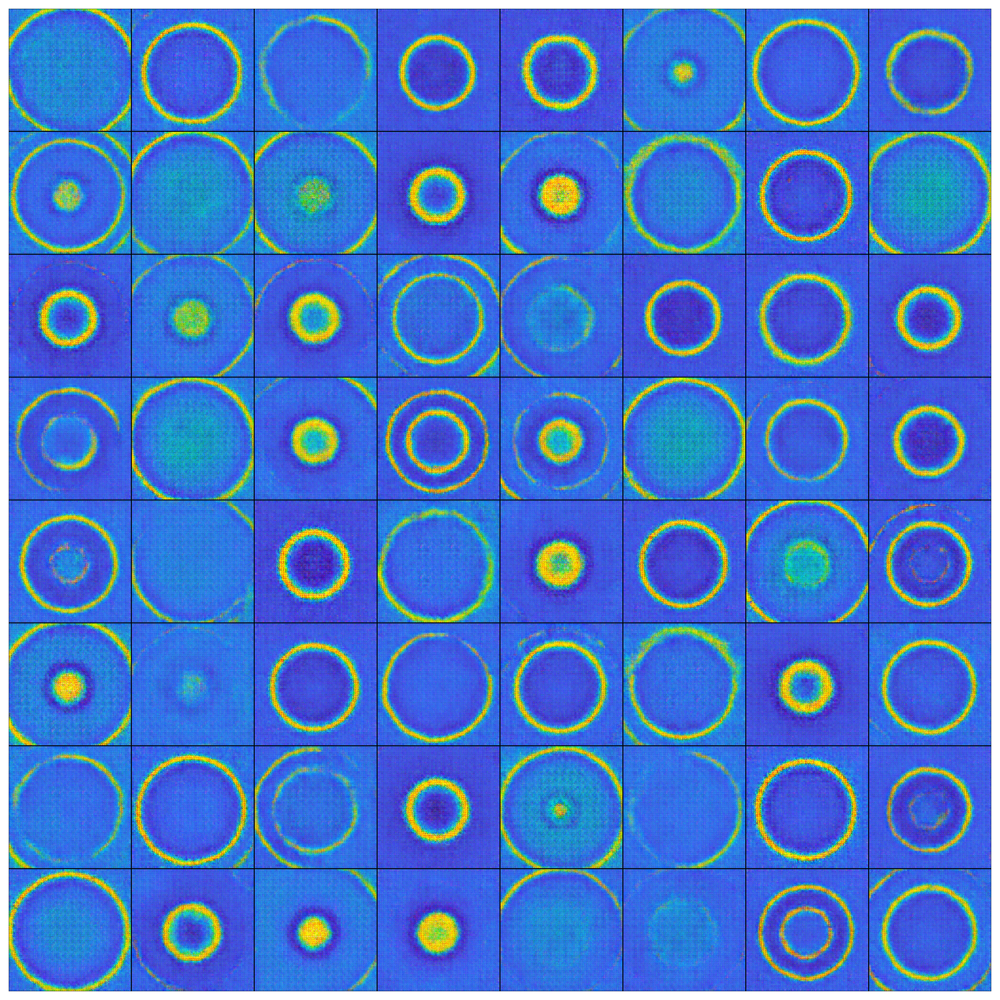

In [81]:
path = f'./generated/generated-images-000{epochs}.png'

if(epochs<10):
    path = f'./generated/generated-images-000{epochs}.png'
elif(epochs<100):
    path = f'./generated/generated-images-000{8}.png'
else:
    path = f'./generated/generated-images-0{epochs}.png'
    
generated_img = cv2.imread(path)
generated_img = generated_img[:, :, [2, 1, 0]]
fig, ax = plt.subplots(figsize=(16, 16))
ax.set_xticks([]); ax.set_yticks([])
ax.imshow((generated_img))

In [82]:
latent_space1 = torch.rand(1, latent_size, 1, 1, device=device)
latent_space2 = torch.rand(1, latent_size, 1, 1, device=device)

Saving generated-images-0000.png
Saving generated-images-0001.png
Saving generated-images-0002.png
Saving generated-images-0003.png
Saving generated-images-0004.png
Saving generated-images-0005.png
Saving generated-images-0006.png
Saving generated-images-0007.png
Saving generated-images-0008.png
Saving generated-images-0009.png
Saving generated-images-0010.png
Saving generated-images-0011.png
Saving generated-images-0012.png
Saving generated-images-0013.png
Saving generated-images-0014.png
Saving generated-images-0015.png
Saving generated-images-0016.png
Saving generated-images-0017.png
Saving generated-images-0018.png
Saving generated-images-0019.png
Saving generated-images-0020.png
Saving generated-images-0021.png
Saving generated-images-0022.png
Saving generated-images-0023.png


/tmp/ipykernel_33/1807794810.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(16, 16))


Saving generated-images-0024.png
Saving generated-images-0025.png
Saving generated-images-0026.png
Saving generated-images-0027.png
Saving generated-images-0028.png
Saving generated-images-0029.png
Saving generated-images-0030.png
Saving generated-images-0031.png
Saving generated-images-0032.png
Saving generated-images-0033.png
Saving generated-images-0034.png
Saving generated-images-0035.png
Saving generated-images-0036.png
Saving generated-images-0037.png
Saving generated-images-0038.png
Saving generated-images-0039.png
Saving generated-images-0040.png
Saving generated-images-0041.png
Saving generated-images-0042.png
Saving generated-images-0043.png
Saving generated-images-0044.png
Saving generated-images-0045.png
Saving generated-images-0046.png
Saving generated-images-0047.png
Saving generated-images-0048.png
Saving generated-images-0049.png
Saving generated-images-0050.png
Saving generated-images-0051.png
Saving generated-images-0052.png
Saving generated-images-0053.png
Saving gen

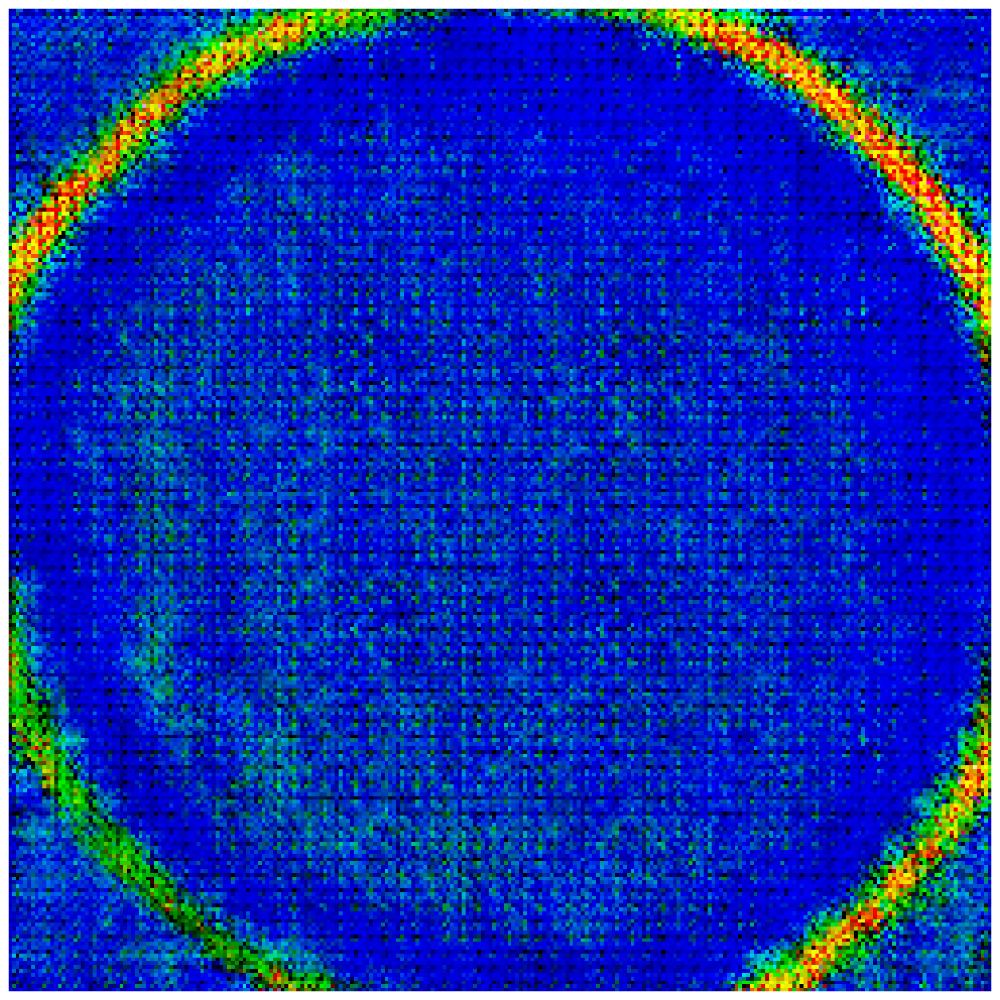

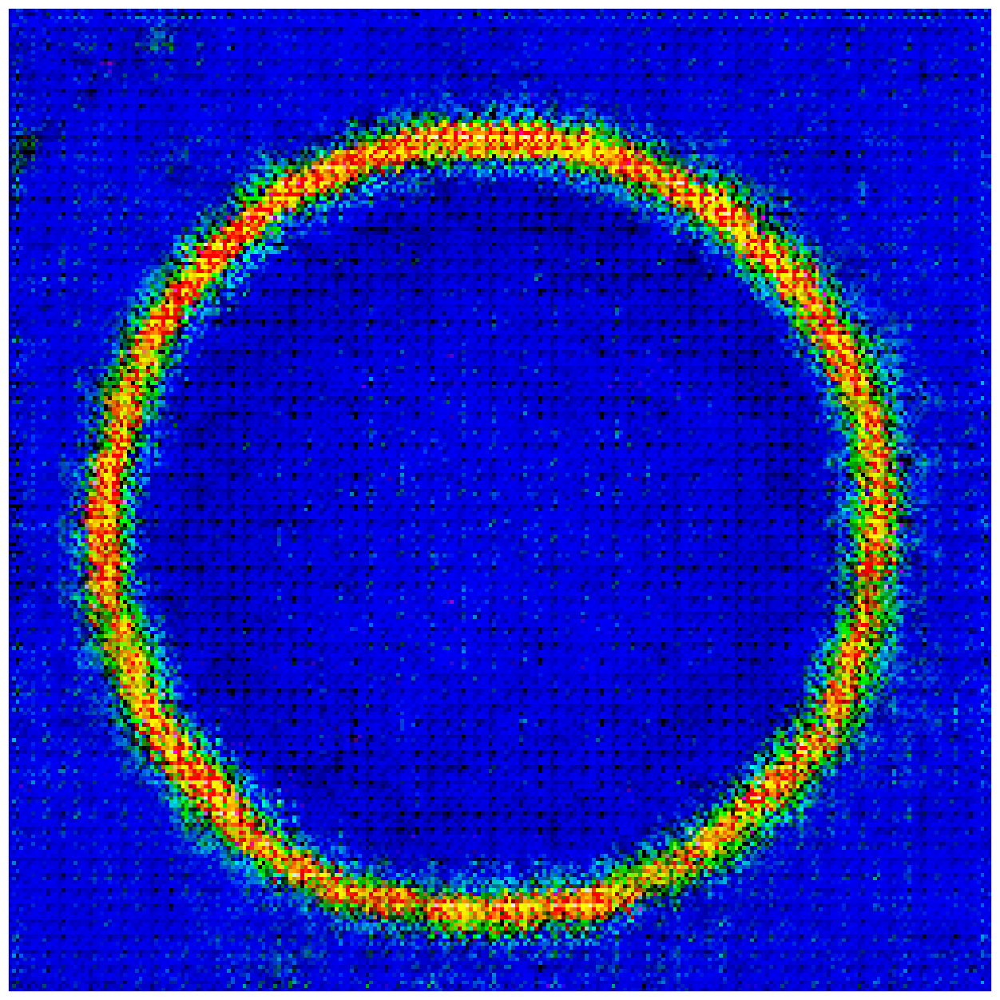

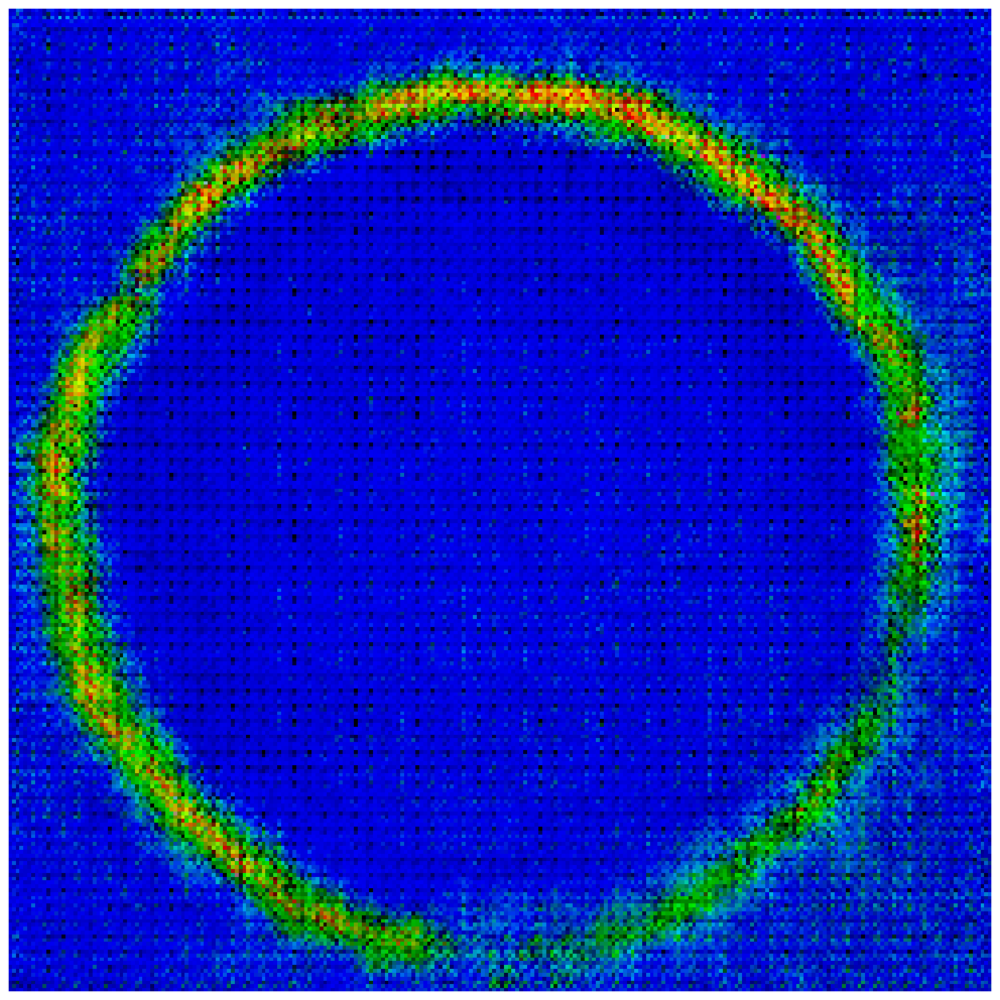

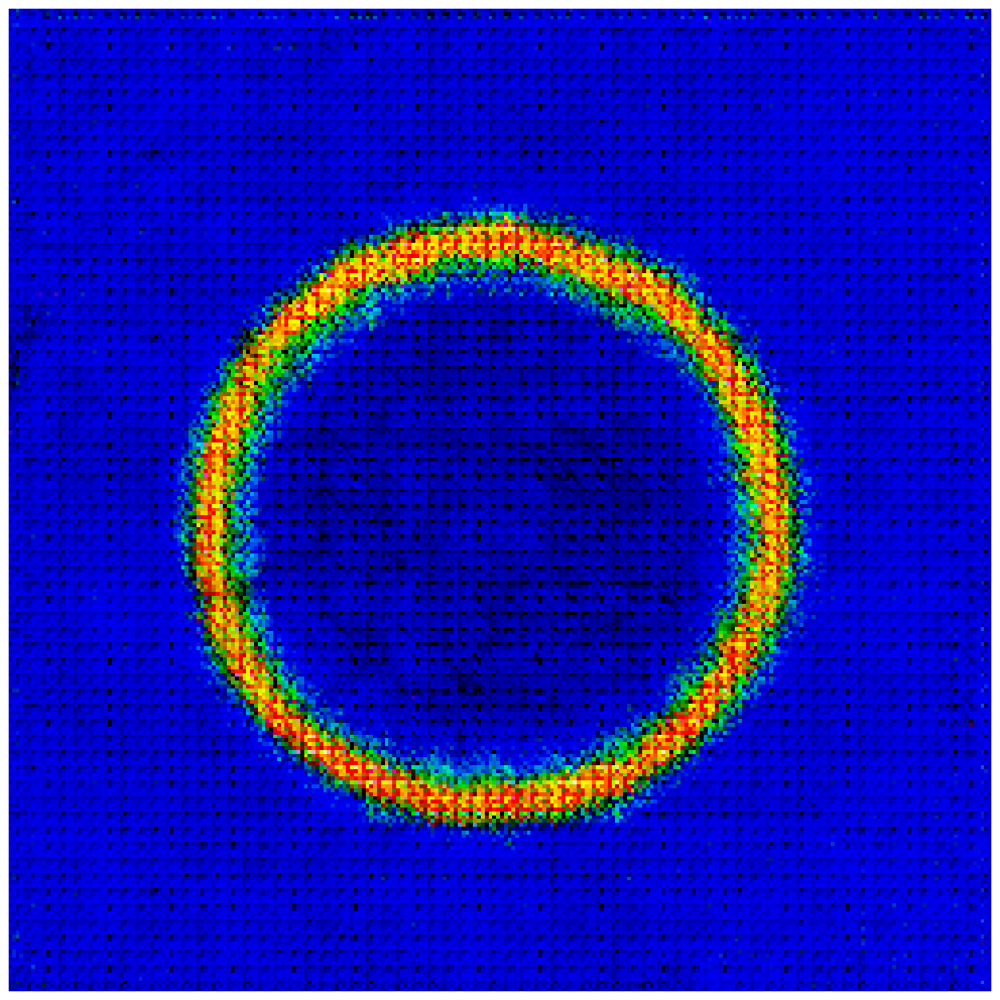

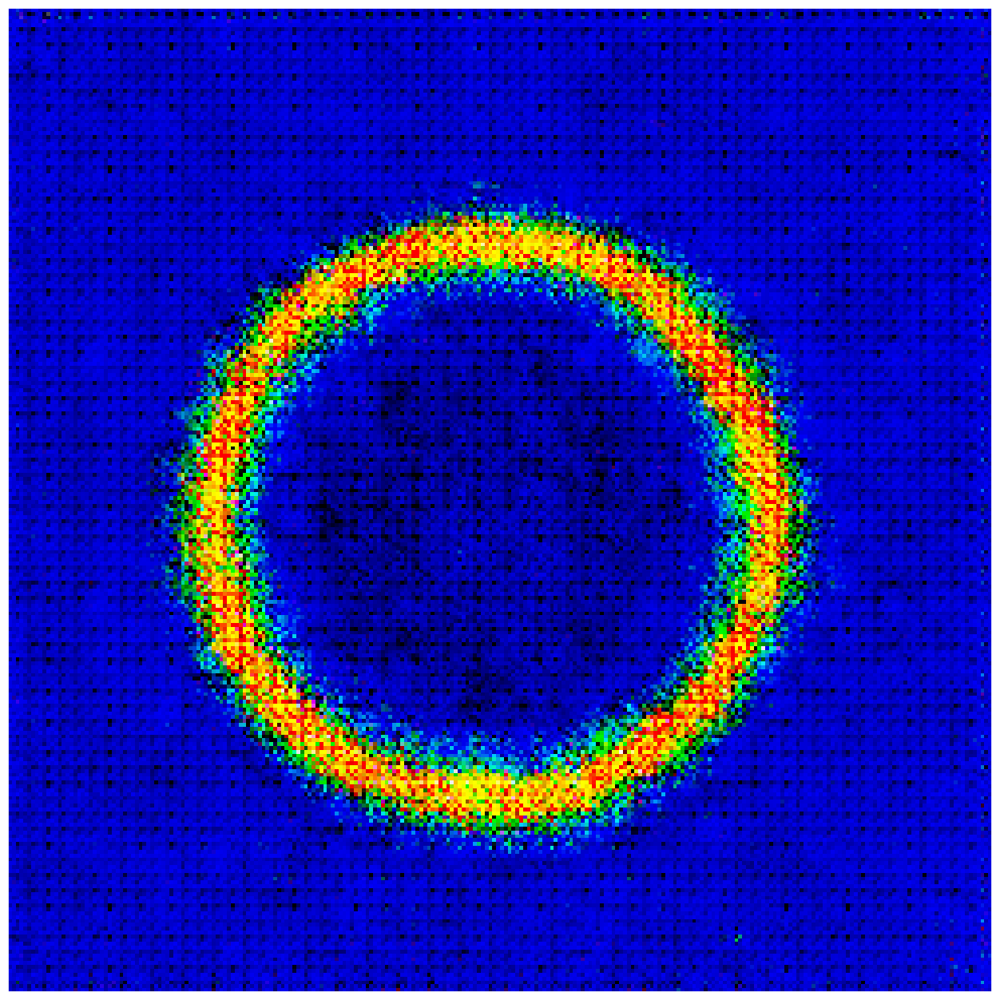

...

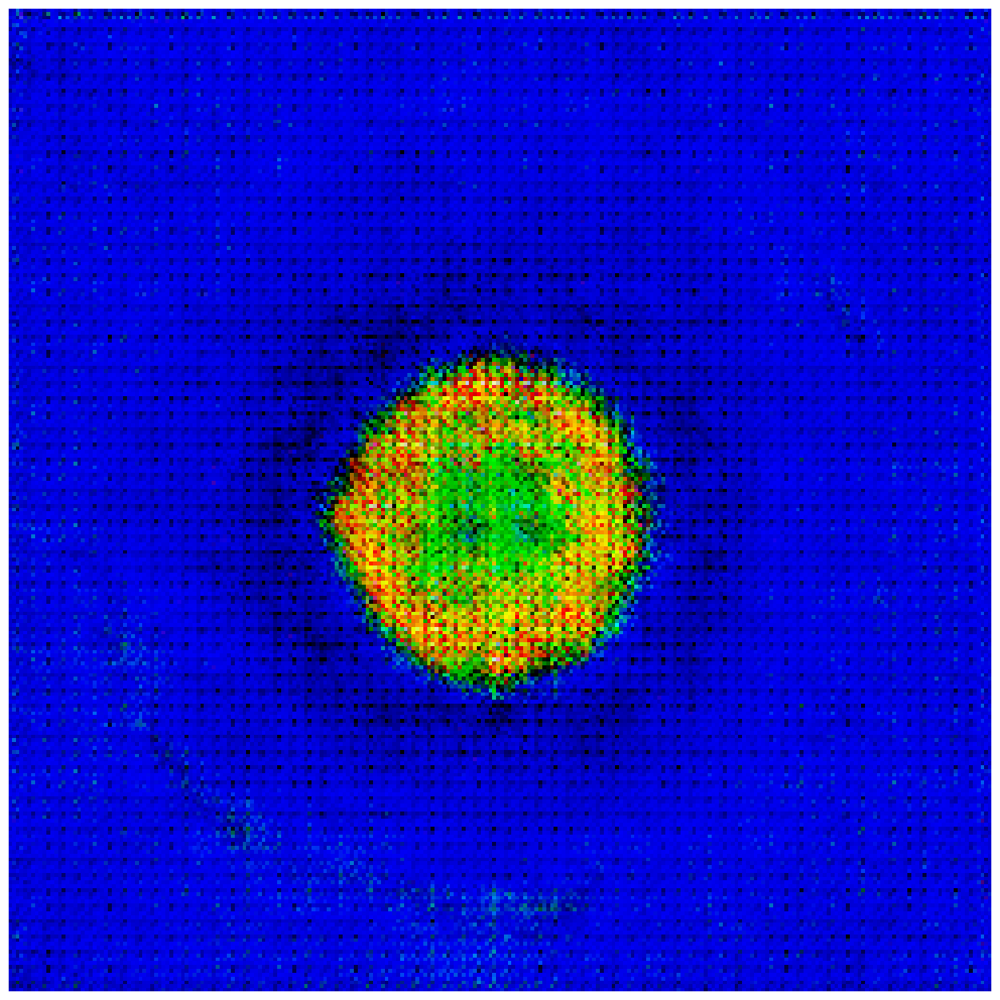

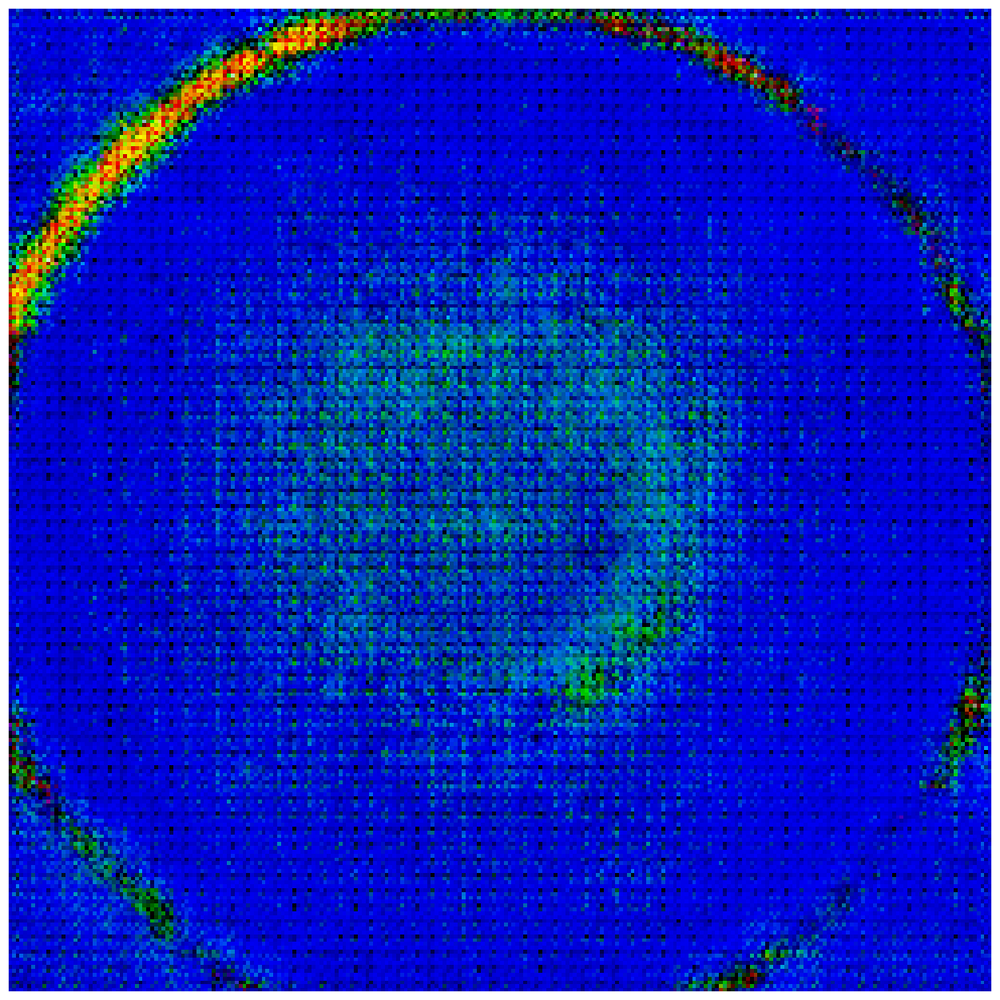

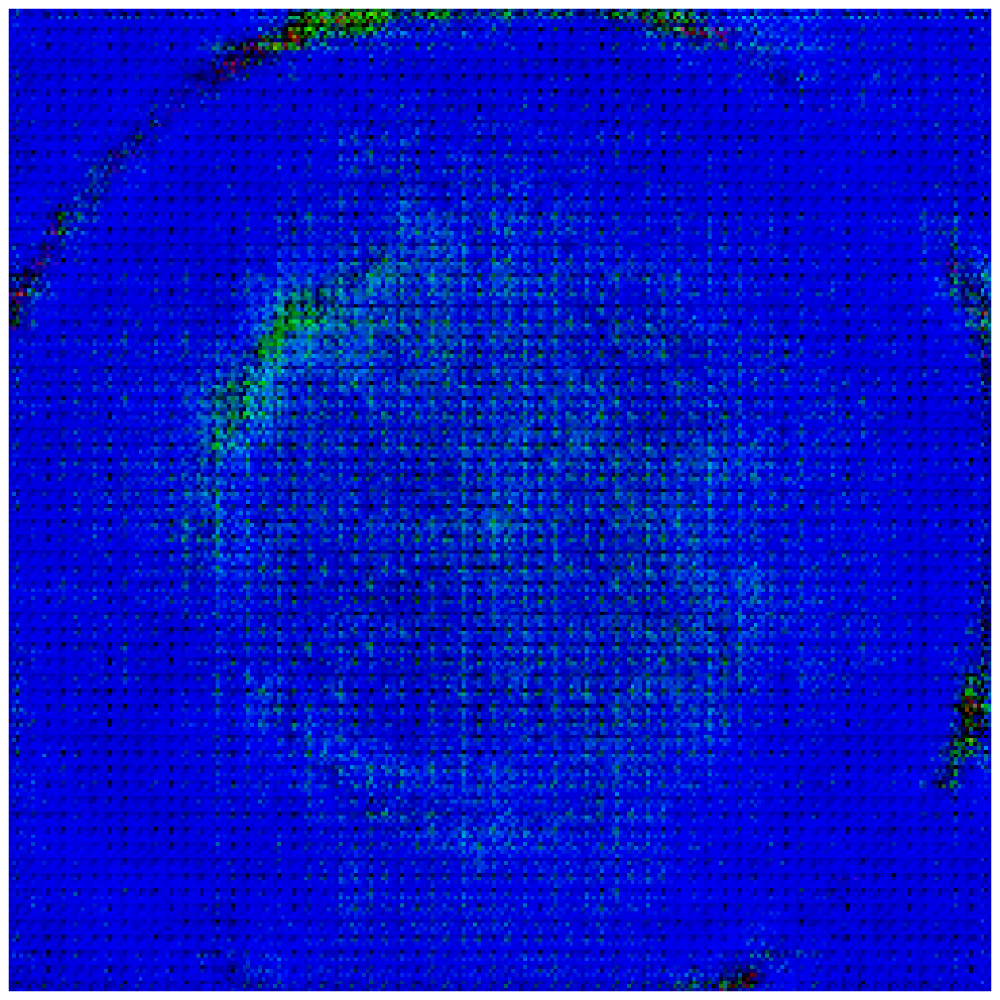

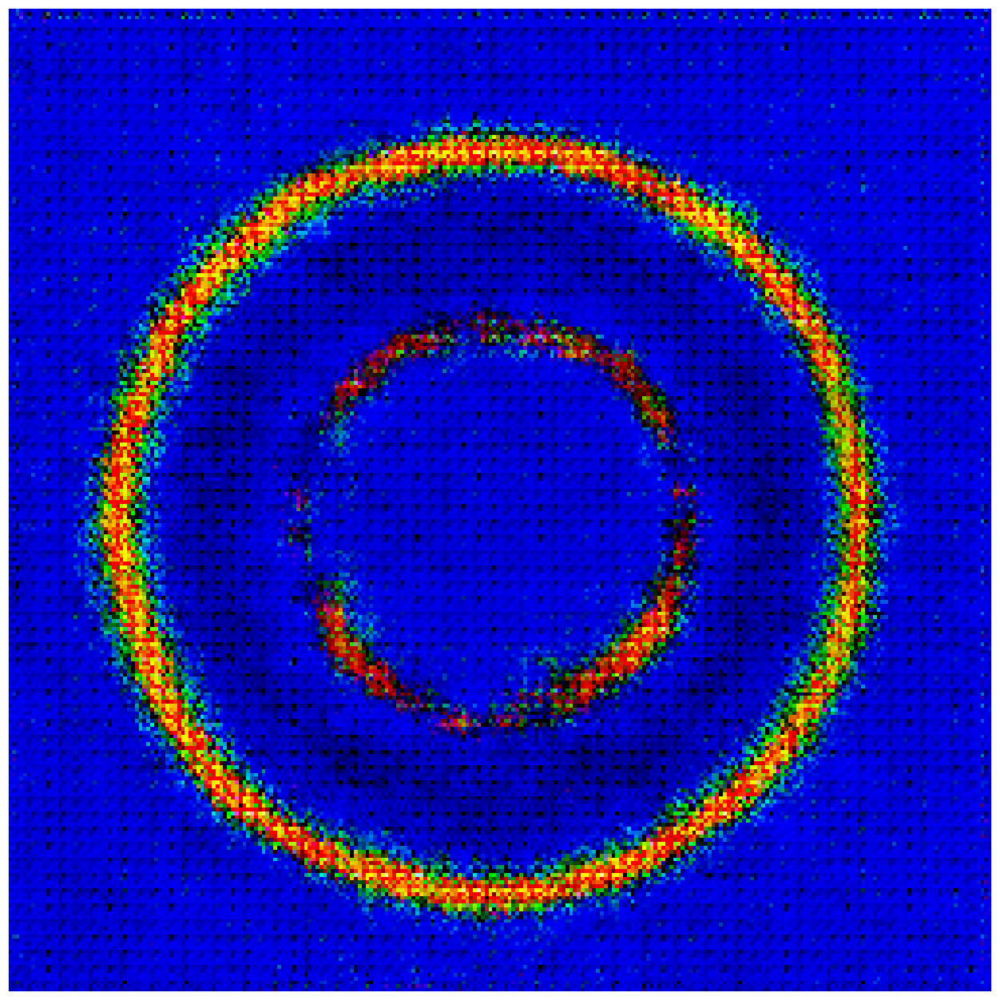

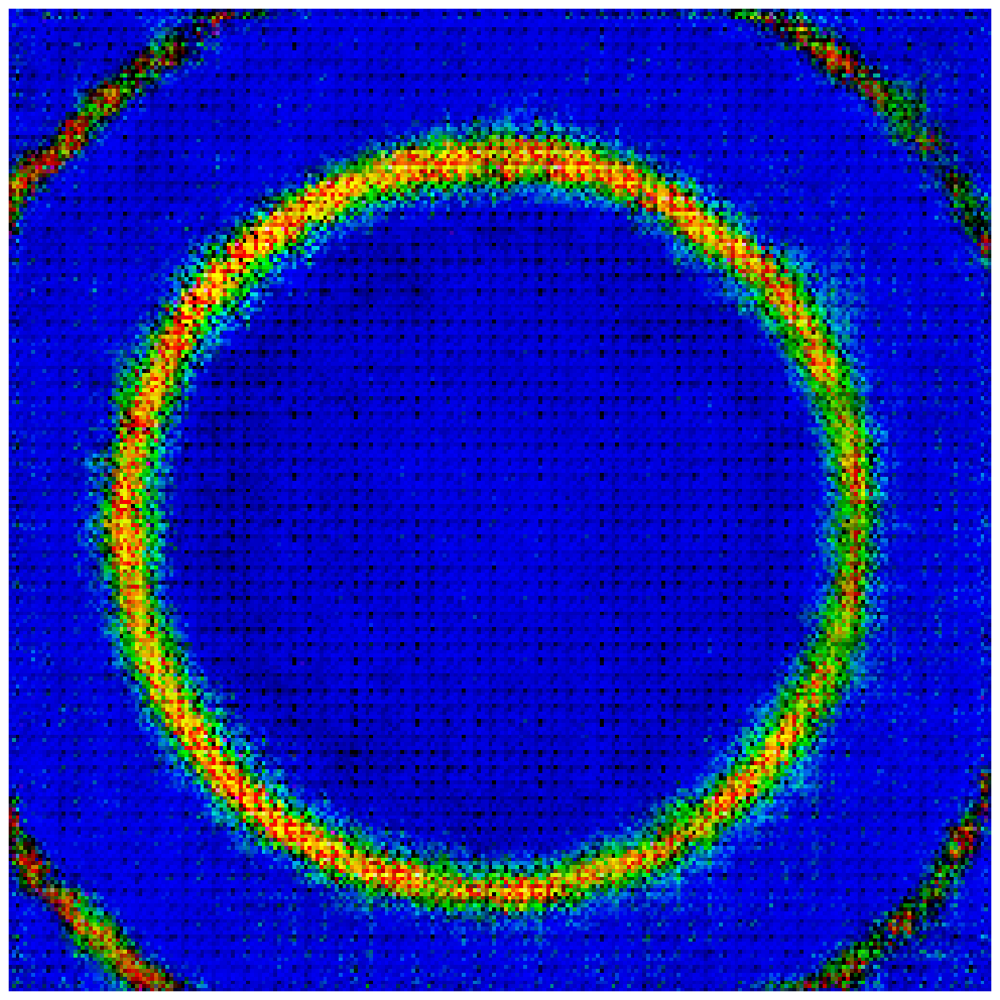

In [90]:
generator.eval()
# gen_img_1 = generator(latent_space1).cpu()
# gen_img_f = generator(fixed_latent[1:2]).cpu()


# gen_img_2 = generator(latent_space2).cpu()
# gen_img_3 = generator(latent_space1-latent_space2).cpu()
# print(gen_img_1.shape)
# show_images(gen_img_1)
# show_images(gen_img_2)
# show_images(gen_img_3)
# show_images(gen_img_f)
for i in range(fixed_latent.shape[0]):
    save_samples(i, fixed_latent[i:i+1], show=True, save_as_200 = True)


In [ ]:
plt.figure(figsize=(15, 6))
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

In [ ]:
plt.figure(figsize=(15, 6))

plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');